In [2]:
import pickle
import numpy as np
import matplotlib.pyplot as plt
import cv2
from matplotlib.animation import FuncAnimation, PillowWriter, FFMpegWriter
from IPython.display import HTML
import random

In [3]:
poses_file = './data/example_keypoints/poses_pair04_synced_ppB.npy'
video_path = '/Users/esamghaleb/Documents/ResearchData/CABB Small Dataset/processed_audio_video/pair04/pair04_synced_ppB.mp4'

In [4]:
frame = int((3*60+18) *29.97) - 20 # the start frame which we be used to extract the pose (the speaker gestures very well starting from frame 500)

In [5]:
mmpose_flip_index = np.concatenate(([0,2,1,4,3,6,5],[17,18,19,20,21,22,23,24,25,26],[7,8,9,10,11,12,13,14,15,16]), axis=0) 
selected_points = np.array([0, 5, 6, 7, 8, 9, 10, 91, 95, 96, 99, 100, 103, 104, 107, 108, 111, 112, 116, 117, 120, 121, 124, 125, 128, 129, 132])
non_selected_points = np.array(range(25, 90))
def miror_poses(data_numpy):
   C,T,V,M = data_numpy.shape
   assert C == 3 # x,y,c
   data_numpy[0, :, :, :] = 1920 - data_numpy[0, :, :, :]
   return data_numpy

def shift_poses(data_numpy):
   C,T,V,M = data_numpy.shape
   print(data_numpy.shape)
   assert V == 27
   for i in range(V): # for each joint
      data_numpy[0, :, i, :] += random.uniform(-20.0, 20.0)  # Random shift in x
      data_numpy[1, :, i, :] += random.uniform(-20.0, 20.0)  # Random shift in y
   return data_numpy
def scale_poses(data_numpy):
   C,T,V,M = data_numpy.shape
   # make the scale random based on the image size
   scales = (random.uniform(0.5, 1.5), random.uniform(0.5, 1.5))
   data_numpy[0, :, :, :] = data_numpy[0, :, :, :] * scales[0]
   data_numpy[1, :, :, :] = data_numpy[1, :, :, :] * scales[1]
   return data_numpy


In [6]:
import numpy as np

np.set_printoptions(precision=4, suppress=True)
poses = np.load(poses_file)



In [10]:
# from feeders.tools import random_move# , random_choose, shift_poses, scale_poses, miror_poses

OpenCV: Couldn't read video stream from file "/Users/esamghaleb/Documents/ResearchData/CABB Small Dataset/processed_audio_video/pair04/pair04_synced_ppB.mp4"


ValueError: Input must be >= 1-d.

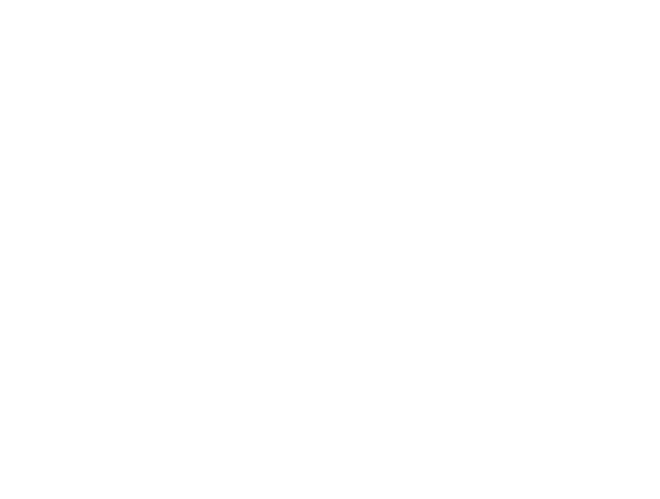

In [11]:
def plot_pose(img, result, scale=(1.0, 1.0)):
    RED = (0, 0, 255)
    GREEN = (0, 255, 0)
    BLUE = (255, 0, 0)
    YELLOW = (0, 255, 255)
    ORANGE = (0, 165, 255)
    PINK = (203, 192, 255)

    # result = result[selected_points]
    # Define limb colors
    limb_colors = [GREEN, BLUE, BLUE, BLUE, BLUE, YELLOW, ORANGE, YELLOW, ORANGE,
                   YELLOW, ORANGE, PINK, RED, PINK, RED, PINK, RED, GREEN, GREEN, GREEN,
                   GREEN, GREEN, GREEN, GREEN, GREEN, GREEN, GREEN, GREEN, GREEN]
    l_pair = ((5, 6), (5, 7),
              (6, 8), (8, 10), (7, 9), (9, 11),
              (12, 13), (12, 14), (12, 16), (12, 18), (12, 20),
              (14, 15), (16, 17), (18, 19), (20, 21),
              (22, 23), (22, 24), (22, 26), (22, 28), (22, 30),
              (24, 25), (26, 27), (28, 29), (30, 31),
              (10, 12), (11, 22))

    part_line = {}
    kp_preds = result[:, :2]
    kp_scores = result[:, 2]
    # Draw keypoints
    for n in range(kp_scores.shape[0]):
        cor_x, cor_y = int(round(kp_preds[n, 0] * scale[0])), int(round(kp_preds[n, 1] * scale[1]))

        # if flip_horizontal:
        #     cor_x = img_width - cor_x  # Flip horizontally

        part_line[n] = (cor_x, cor_y)
        cv2.circle(img, (cor_x, cor_y), 1, (0, 0, 255), -1)

    # Draw limbs with colors
    for i, (start_p, end_p) in enumerate(l_pair):
        start_p = int(start_p) - 5
        end_p = int(end_p) - 5
        if start_p in part_line and end_p in part_line:
            start_p = part_line[start_p]
            end_p = part_line[end_p]
            cv2.line(img, start_p, end_p, limb_colors[i], 3)
    
    return img

def plot_pose_dots(img, result, scale=(1.0, 1.0)):
    RED = (0, 0, 255)
    kp_preds = result[:, :2]
    kp_scores = result[:, 2]
    
    # Draw keypoints as thicker circles (radius 4)
    for n in range(kp_scores.shape[0]):
        x = int(round(kp_preds[n, 0] * scale[0]))
        y = int(round(kp_preds[n, 1] * scale[1]))
        cv2.circle(img, (x, y), 3, RED, -1)
    
    return img

def load_poses(file_path, flip_horizontal=False, random_shift_poses=False, random_scale=False, random_move_poses=False, select_points = False):
    poses = np.load(file_path, allow_pickle=True)
    if select_points:
        poses = poses[:,selected_points,:]
    else:
        # select the non selected points
        poses = poses[:,non_selected_points,:]
    # poses = poses[:,selected_points,:]
    # add one dimension to the pose at the end

    poses = np.expand_dims(poses, axis=-1)
    # original shape is T, V, C, M
    T, V, C, M = poses.shape
    poses = np.transpose(poses, (2, 0, 1, 3))

    if random_move_poses:
        print("Random move")
        # but we need # input: C,T,V,M
        poses = random_move(poses)
        # revserse the shape to the original shape
    if flip_horizontal:
        print("Flip horizontal")
        poses = miror_poses(poses)
    # random scale
    if random_scale:
        print("Random scale")
        poses = scale_poses(poses)
  
    if random_shift_poses:
        print("Random shift")
        poses = shift_poses(poses)
            
    C, T, V, M = poses.shape
    poses = np.transpose(poses, (1, 2, 0, 3))
    # remove the last dimension
    poses = np.squeeze(poses)
    return poses

def process_frame(poses, orig_poses, frame_index, video_capture):
    video_capture.set(cv2.CAP_PROP_POS_FRAMES, frame_index)
    ret, img = video_capture.read()
 
    if not ret:
        return None
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = plot_pose_dots(img, orig_poses[frame_index])
    img_with_pose = plot_pose(img, poses[frame_index])
    return img_with_pose

# Load the poses
poses = load_poses(poses_file, select_points=True)
orig_poses = load_poses(poses_file, select_points=False)
max_x = np.max(poses[:, :, 0])
max_y = np.max(poses[:, :, 1])
min_x = np.min(poses[:, :, 0])
min_y = np.min(poses[:, :, 1])
# Open the video file
cap = cv2.VideoCapture(video_path)
# set the first frame to frame = 9000
# start_frame = int((3*60+18) *29.97)+12# the start frame which we be used to extract the pose for ACL paper
start_frame = int((3*60+18) *29.97)-200# the start frame which we be used to extract the pose 

all_images = []
for i in range(50):
    cap.set(cv2.CAP_PROP_POS_FRAMES, start_frame-1)
    # Read the the image at the start frame
    ret, first_frame = cap.read()
    if ret:
        first_frame = cv2.cvtColor(first_frame, cv2.COLOR_BGR2RGB)

    fig, ax = plt.subplots()
    ax.axis('off')  # Hide the axes
    ax.set_position([0, 0, 1, 1])  # Set the position of the axes to fill the whole figure
    fig.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=0, hspace=0)  # Adjust subplot parameters to remove white space

    img_with_pose = process_frame(poses, orig_poses, start_frame, cap)
    # using max and min to crop the image
    ax.set_xlim(min_x+800, max_x-120)
    ax.set_ylim(min_y+370, max_y-180)
    # flipt the image
    image_flipped = np.flipud(img_with_pose)
    img_display = ax.imshow(image_flipped)
    start_frame += 5
    cropped = img_with_pose[int(min_y+300):int(max_y-250), int(min_x+810):int(max_x-120)]
    
    # Flip the cropped image if desired.
    image_flipped = np.flipud(cropped)
    
    # Append the actual image array, not the matplotlib artist.
    all_images.append(cropped)
    
    start_frame += 2
# Check that all images have the same shape:
shapes = [img.shape for img in all_images]
print("Image shapes:", shapes)

# If they are all the same height, you can concatenate horizontally (axis=1)
concatenated = np.concatenate(all_images, axis=1)

# Save the concatenated image.
# If your image is in RGB, and cv2.imwrite expects BGR, convert it:
cv2.imwrite('concatenated_result.png', cv2.cvtColor(concatenated, cv2.COLOR_RGB2BGR))

# Alternatively, using matplotlib:
plt.imsave('concatenated_result_matplotlib.png', concatenated)

In [ ]:
def load_poses(file_path, flip_horizontal=False, random_shift_poses=False, random_scale=False, random_move_poses=False):
    poses = np.load(file_path, allow_pickle=True)
    # poses = poses[:,selected_points,:]
    # add one dimension to the pose at the end
    poses = np.expand_dims(poses, axis=-1)
    # original shape is T, V, C, M
    T, V, C, M = poses.shape
    poses = np.transpose(poses, (2, 0, 1, 3))

    if random_move_poses:
        print("Random move")
        # but we need # input: C,T,V,M
        poses = random_move(poses)
        # revserse the shape to the original shape
    if flip_horizontal:
        print("Flip horizontal")
        poses = miror_poses(poses)
    # random scale
    if random_scale:
        print("Random scale")
        poses = scale_poses(poses)
  
    if random_shift_poses:
        print("Random shift")
        poses = shift_poses(poses)
            
    C, T, V, M = poses.shape
    poses = np.transpose(poses, (1, 2, 0, 3))
    # remove the last dimension
    poses = np.squeeze(poses)
    return poses

def process_frame(poses, frame_index, video_capture):
    video_capture.set(cv2.CAP_PROP_POS_FRAMES, frame_index)
    ret, img = video_capture.read()
    # flip the image
    img = cv2.flip(img, 1)
    if not ret:
        return None
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    img_with_pose = plot_pose(img, poses[frame_index])
    return img_with_pose

# Load the poses
poses = load_poses(file_path, flip_horizontal=True)

# Open the video file
cap = cv2.VideoCapture(video_path)

# set the first frame to frame = 9000
cap.set(cv2.CAP_PROP_POS_FRAMES, frame)
# Read the first frame to set up the initial image
ret, first_frame = cap.read()
if ret:
    first_frame = cv2.cvtColor(first_frame, cv2.COLOR_BGR2RGB)

fig, ax = plt.subplots()
ax.axis('off')  # Hide the axes
ax.set_position([0, 0, 1, 1])  # Set the position of the axes to fill the whole figure
fig.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=0, hspace=0)  # Adjust subplot parameters to remove white space

img_display = ax.imshow(first_frame)  # Initialize with the first frame and adjust aspect

def update(frame):
    img_with_pose = process_frame(poses, frame, cap)
    if img_with_pose is not None:
        img_display.set_data(img_with_pose)
    return img_display,

# Creating the animation
ani = FuncAnimation(fig, update, frames=60, interval=100, blit=True)

# Display the animation in Jupyter Notebook
html = HTML(ani.to_jshtml())
cap.release()  
html

NameError: name 'poses_file' is not defined

Flip horizontal


Animation size has reached 21072676 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


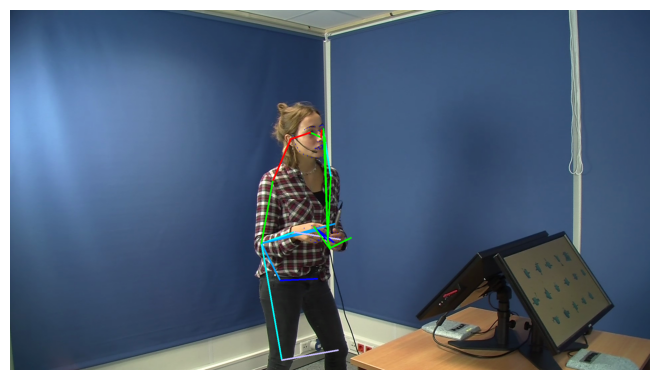

In [ ]:
# Open the video file
poses = load_poses(poses_file, flip_horizontal=True, random_shift_poses=False, random_scale=False, random_move_poses=False)
cap = cv2.VideoCapture(video_path)
# Read the first frame to set up the initial image
ret, first_frame = cap.read()
if ret:
    first_frame = cv2.cvtColor(first_frame, cv2.COLOR_BGR2RGB)

fig, ax = plt.subplots()
ax.axis('off')  # Hide the axes
ax.set_position([0, 0, 1, 1])  # Set the position of the axes to fill the whole figure
fig.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=0, hspace=0)  # Adjust subplot parameters to remove white space

img_display = ax.imshow(first_frame)

def update(frame):
    img_with_pose = process_frame(poses, frame, cap)
    if img_with_pose is not None:
        img_display.set_data(img_with_pose)
    return img_display,

# Creating the animation
ani = FuncAnimation(fig, update, frames=360, interval=100, blit=True)

# Creating and saving the animation
output_video_path = 'video.mp4'
writer = FFMpegWriter(fps=30)  # Adjust FPS as needed
# ani.save(output_video_path, writer=writer)

# Display the animation in Jupyter Notebook
html = HTML(ani.to_jshtml())
cap.release()
html